# Install Required Libraries

In [1]:
!pip install ultralytics==8.0.20
!pip install torch torchvision opencv-python-headless albumentations

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.2/261.2 kB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 23.3 MB/s eta 0:00:00


In [2]:
!nvidia-smi

Fri Dec  6 09:08:29 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Import Libraries

In [3]:
import os
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from ultralytics import YOLO
import albumentations as A
from albumentations.pytorch import ToTensorV2
import matplotlib.pyplot as plt

/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


# Mount Google Drive

In [7]:
from google.colab import drive
drive.mount('/content/drive')

# Change to working directory
%cd /content/drive/MyDrive/weapons

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/weapons


# YOLO CLI Training Method

In [5]:
# Ensure your `data.yaml` file is correctly configured with paths to training and validation datasets.

!yolo task=detect mode=train model=yolov8s.pt data=data.yaml epochs=20 imgsz=224 plots=True

Streaming output truncated to the last 5000 lines.
  with torch.cuda.amp.autocast(self.amp):
      14/20     0.803G     0.7968     0.8753      1.205         16        224:  76% 279/369 [01:14<00:18,  4.88it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/yolo/engine/trainer.py:299: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(self.amp):
      14/20     0.803G     0.7966     0.8754      1.205         16        224:  76% 280/369 [01:14<00:17,  5.11it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/yolo/engine/trainer.py:299: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(self.amp):
      14/20     0.803G     0.7969     0.8752      1.205         19        224:  76% 281/369 [01:14<00:21,  4.06it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/yolo/engine/train

# Validate Custom Model (YOLO CLI)


In [10]:
!yolo task=detect mode=val model=/content/drive/MyDrive/weapons/runs/detect/train4/weights/best.pt data=data.yaml


/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py:332: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(file, map_location='cpu')  # load
2024-1

# Inference with Custom YOLO Model (CLI)

/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py:332: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(file, map_location='cpu')  # load
Ultral

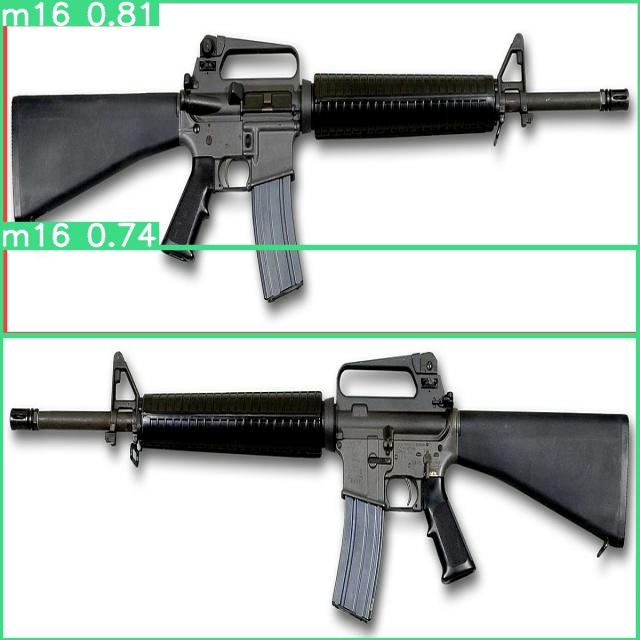

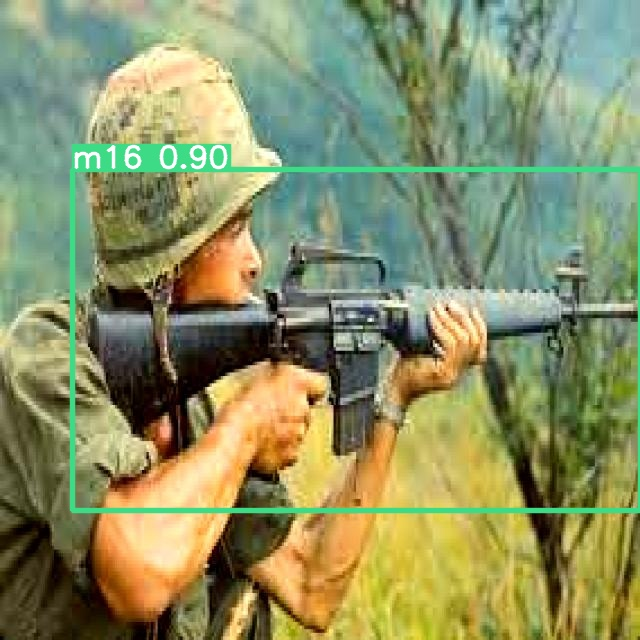

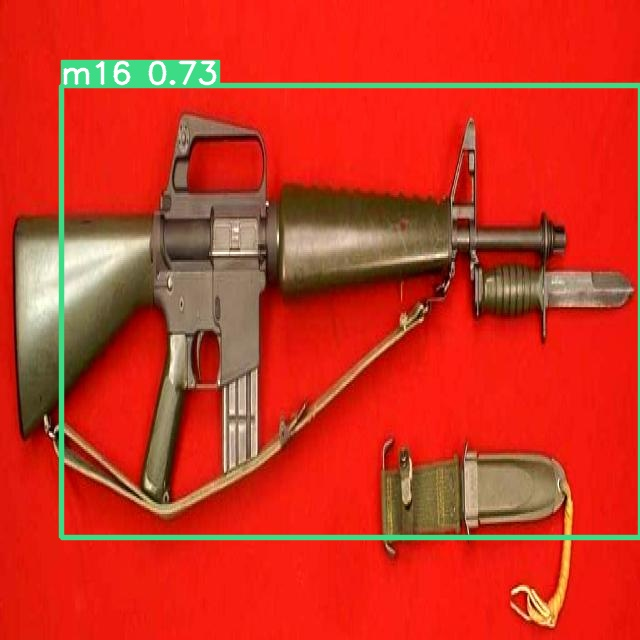

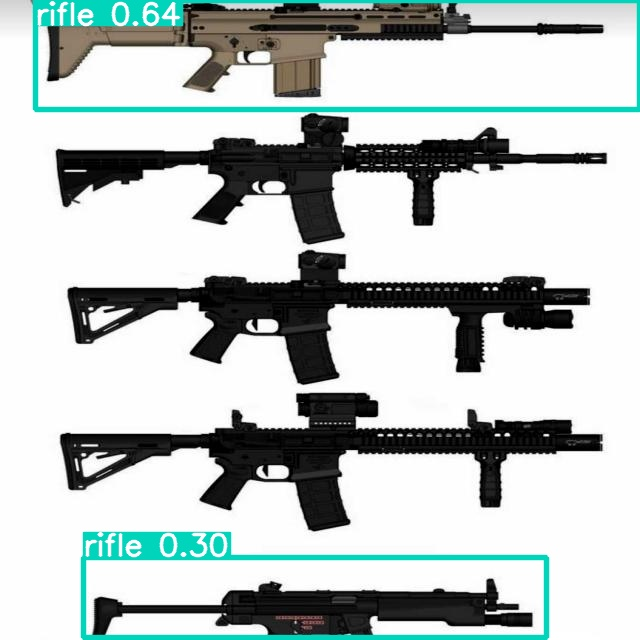

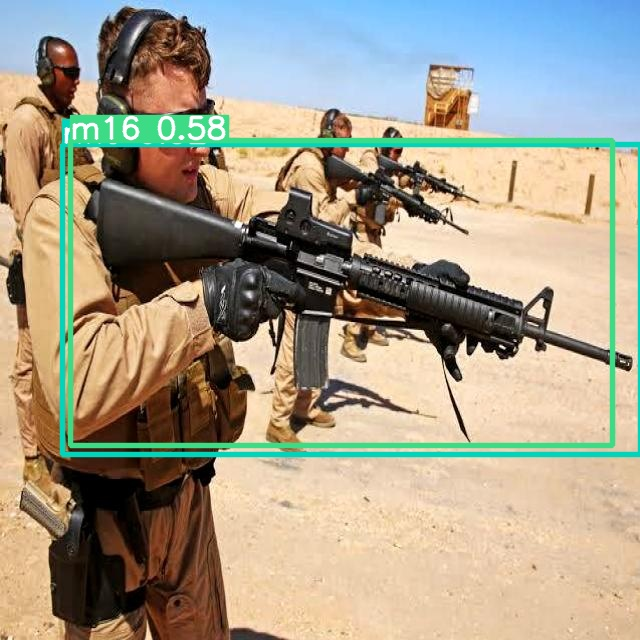

...

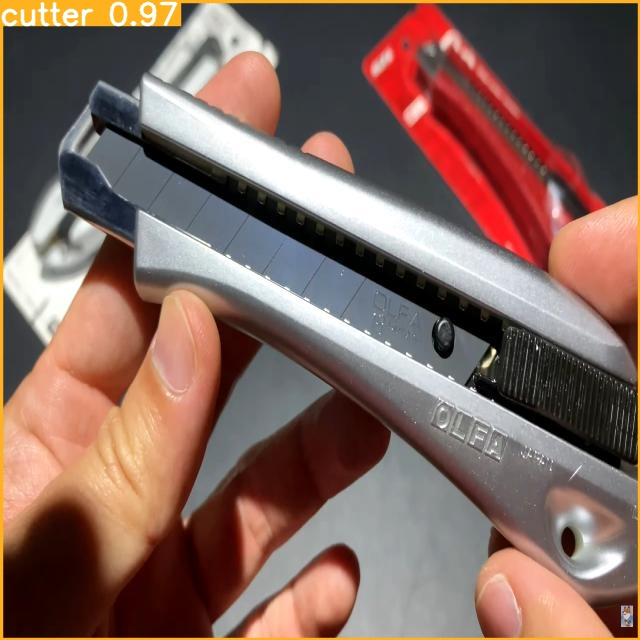

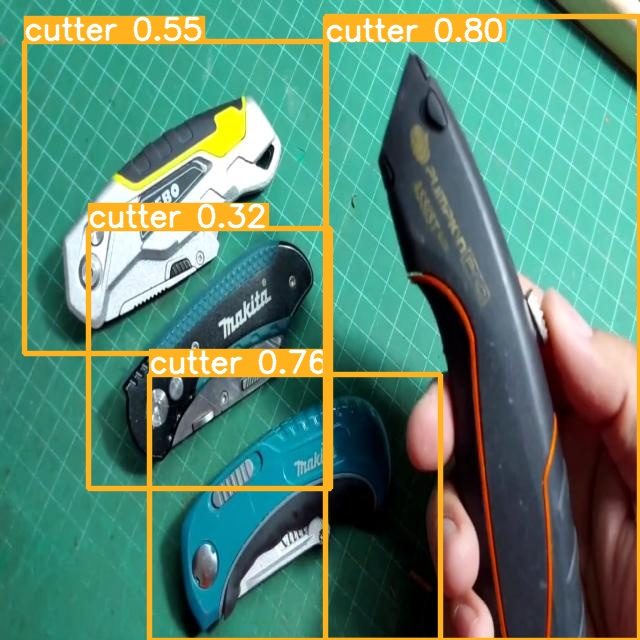

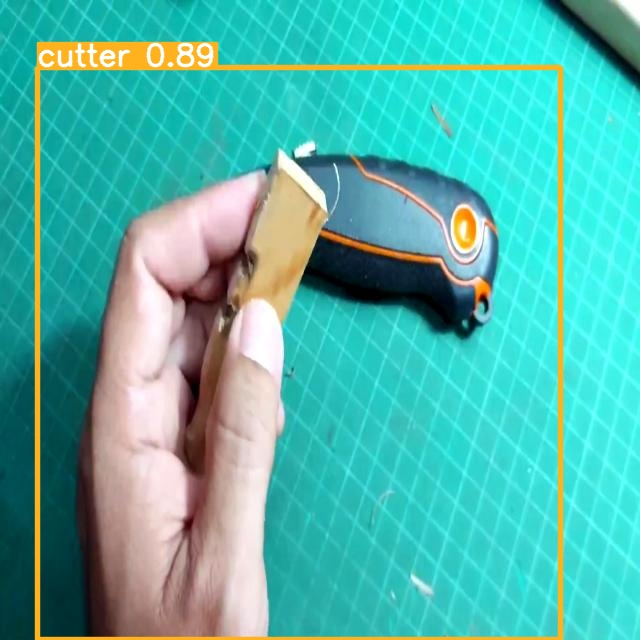

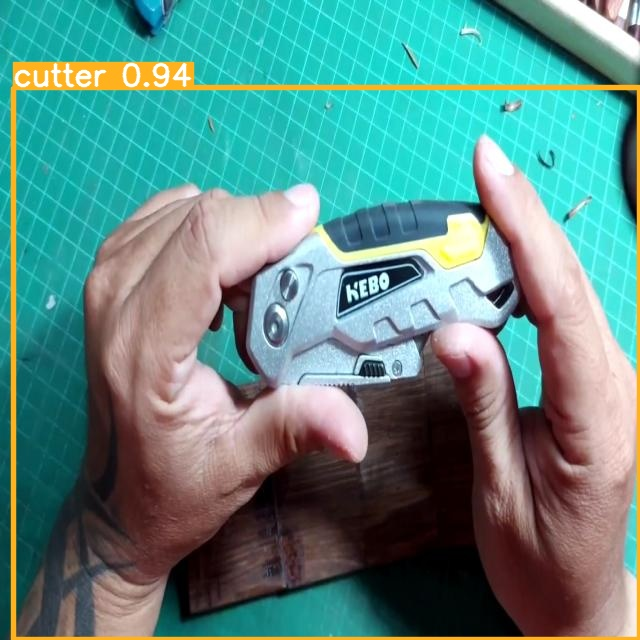

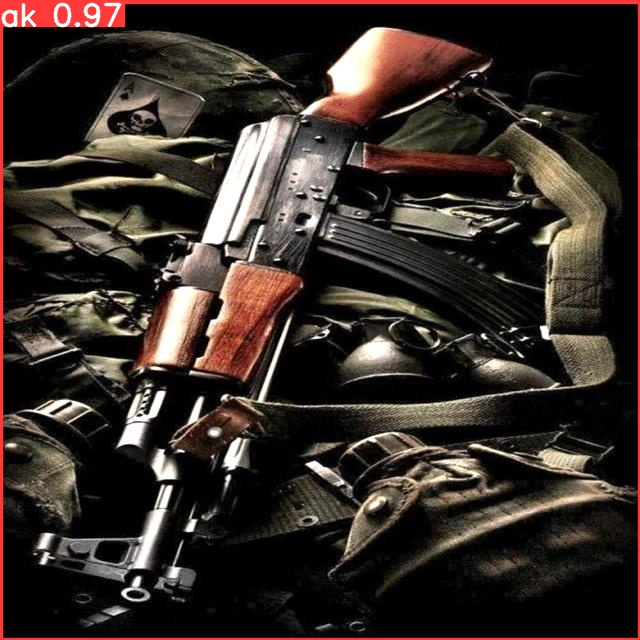

In [48]:
from ultralytics import YOLO

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/weapons/runs/detect/train4/weights/best.pt')

# Run predictions on the test images
results = model.predict(
    source='/content/drive/MyDrive/weapons/test/images',  # Path to test images
    conf=0.25,  # Confidence threshold
    save=True  # Save results in the 'runs/detect/predict' folder
)

# Display the results
import glob
from IPython.display import Image, display

for image_path in glob.glob('runs/detect/predict/*.jpg'):
    display(Image(filename=image_path))


In [49]:
# Evaluate the model's performance on the test dataset
metrics = model.val(data='/content/drive/MyDrive/weapons/data.yaml')  # Path to your dataset config file

# View evaluation metrics
print(metrics)


Ultralytics YOLOv8.0.20 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
val: Scanning /content/drive/MyDrive/weapons/valid/labels.cache... 552 images, 10 backgrounds, 0 corrupt: 100%|██████████| 562/562 [00:00<?, ?it/s]
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 60, len(boxes) = 581. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   3%|▎         | 1/36 [00:03<01:58,  3.40s/it]Exception in thread Exception in thread Thread-17 (plot_images):
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/local/lib/python3.10/dist-packages/sentry_sdk/integrations/threading.py", line 101, in run
    return _run_old_run_func()
  File "/usr/local/lib/python3.10/

None


# Incorporate Image Preprocessing

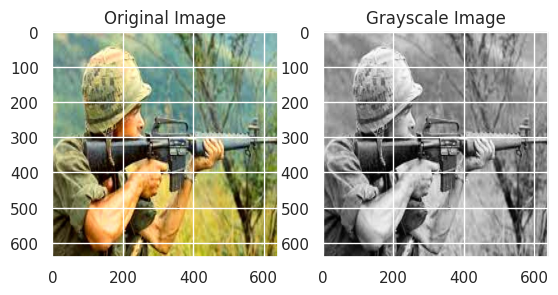

In [54]:
import cv2
import matplotlib.pyplot as plt

# Load and preprocess an image
image_path = "/content/drive/MyDrive/weapons/test/images/A005-0072_jpg.rf.683c12458535b11a31666e1a4bd2b38c.jpg"
image = cv2.imread(image_path)
image_resized = cv2.resize(image, (640, 640))  # Resize to YOLO input size
image_gray = cv2.cvtColor(image_resized, cv2.COLOR_BGR2GRAY)  # Convert to grayscale

# Display original and processed images
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.subplot(1, 2, 2)
plt.title("Grayscale Image")
plt.imshow(image_gray, cmap="gray")
plt.show()


# Highlight Detection Results

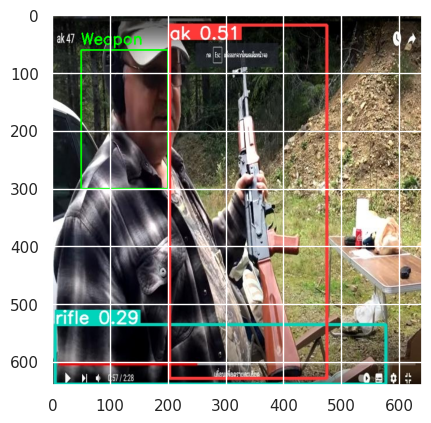

In [63]:
from PIL import Image

results_path = "/content/drive/MyDrive/weapons/runs/detect/predict"
image = cv2.imread(f"{results_path}/A06-097_jpg.rf.d78eb8a2e31faa2efe107175c59e435d.jpg")
boxes = [[50, 60, 200, 300]]  # Example bounding box
class_labels = ["Weapon"]  # Example label

for box, label in zip(boxes, class_labels):
    x1, y1, x2, y2 = box
    cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.show()
